<a href="https://colab.research.google.com/github/FariskaRatna/face-mask-mmyolo/blob/main/Face_Mask_mmyolo.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Prepare Dataset**

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
import shutil
import os, sys

zip_file = "/content/drive/MyDrive/Face Mask Detection/face-mask-dataset.zip"
os.mkdir("data/")

if os.path.isfile(zip_file):
  shutil.unpack_archive(zip_file, "/content/data/")
else:
  print(zip_file + " not found")

In [3]:
import os, shutil, random

full_data_path = "/content/data/obj/"
extension_allowed = ".jpg"
# split_percentage = 100

images_path = "/content/data/images/"
if os.path.exists(images_path):
  shutil.rmtree(images_path)
os.mkdir(images_path)

labels_path = "/content/data/labels/"
if os.path.exists(labels_path):
  shutil.rmtree(labels_path)
os.mkdir(labels_path)

training_images = images_path + "training/"
# validation_images = images_path + "validation/"
training_labels = labels_path + "training/"
# validation_labels = labels_path + "validation/"

os.mkdir(training_images)
# os.mkdir(validation_images)
os.mkdir(training_labels)
# os.mkdir(validation_labels)

files = []

ext_len = len(extension_allowed)
for r, d, f in os.walk(full_data_path):
  for file in f:
    if file.endswith(extension_allowed):
      strip = file[0:len(file) - ext_len]
      files.append(strip)

random.shuffle(files)
size = len(files)
# split = int(split_percentage * size / 100)

print("copying data")
for i in range(size):
  strip = files[i]

  image_file = strip + extension_allowed
  src_image = full_data_path + image_file
  shutil.copy(src_image, training_images)

  label_file = strip + ".txt"
  src_label = full_data_path + label_file
  shutil.copy(src_label, training_labels)

# print("copying validation data")
# for i in range(split, size):
#   strip = files[i]

#   image_file = strip + extension_allowed
#   src_image = full_data_path + image_file
#   shutil.copy(src_image, validation_images)

#   label_file = strip + ".txt"
#   src_label = full_data_path + label_file
#   shutil.copy(src_label, validation_labels)

print("finished")

copying data
finished


## **Convert COCO Dataset**

In [6]:
!git clone https://github.com/Taeyoung96/Yolo-to-COCO-format-converter.git
%cd Yolo-to-COCO-format-converter

Cloning into 'Yolo-to-COCO-format-converter'...
remote: Enumerating objects: 278, done.
remote: Counting objects: 100% (70/70), done.
remote: Compressing objects: 100% (35/35), done.
remote: Total 278 (delta 46), reused 47 (delta 35), pack-reused 208
Receiving objects: 100% (278/278), 30.92 MiB | 39.04 MiB/s, done.
Resolving deltas: 100% (64/64), done.
/content/Yolo-to-COCO-format-converter


In [7]:
from IPython.core.magic import register_line_cell_magic

@register_line_cell_magic
def writetemplate(line, cell):
    with open(line, 'w') as f:
        f.write(cell.format(**globals()))

In [8]:
%%writefile /content/Yolo-to-COCO-format-converter/main.py

from pathlib import Path

from create_annotations import (
    create_image_annotation,
    create_annotation_from_yolo_format,
    create_annotation_from_yolo_results_format,
    coco_format,
)
import cv2
import argparse
import json
import numpy as np
import imagesize

#################################################
# Change the classes depend on your own dataset.#
# Don't change the list name 'Classes'          #
#################################################

YOLO_DARKNET_SUB_DIR = "YOLO_darknet"

classes = [
    "with mask",
    "without mask"
]


def get_images_info_and_annotations(opt):
    path = Path(opt.path)
    annotations = []
    images_annotations = []
    if path.is_dir():
        file_paths = sorted(path.rglob("*.jpg"))
        file_paths += sorted(path.rglob("*.jpeg"))
        file_paths += sorted(path.rglob("*.png"))
    else:
        with open(path, "r") as fp:
            read_lines = fp.readlines()
        file_paths = [Path(line.replace("\n", "")) for line in read_lines]

    image_id = 0
    annotation_id = 1  # In COCO dataset format, you must start annotation id with '1'

    for file_path in file_paths:
        # Check how many items have progressed
        print("\rProcessing " + str(image_id) + " ...", end='')

        # Build image annotation, known the image's width and height
        w, h = imagesize.get(str(file_path))
        image_annotation = create_image_annotation(
            file_path=file_path, width=w, height=h, image_id=image_id
        )
        images_annotations.append(image_annotation)

        label_file_name = f"{file_path.stem}.txt"
        if opt.yolo_subdir:
            annotations_path = file_path.parent / YOLO_DARKNET_SUB_DIR / label_file_name
        else:
            annotations_path = file_path.parent / label_file_name

        if annotations_path.exists(): # The image may not have any applicable annotation txt file.
            with open(str(annotations_path), "r") as label_file:
                label_read_line = label_file.readlines()

            # yolo format - (class_id, x_center, y_center, width, height)
            # coco format - (annotation_id, x_upper_left, y_upper_left, width, height)
            for line1 in label_read_line:
                label_line = line1
                category_id = (
                    int(label_line.split()[0]) + 1
                )  # you start with annotation id with '1'
                x_center = float(label_line.split()[1])
                y_center = float(label_line.split()[2])
                width = float(label_line.split()[3])
                height = float(label_line.split()[4])

                float_x_center = w * x_center
                float_y_center = h * y_center
                float_width = w * width
                float_height = h * height

                min_x = int(float_x_center - float_width / 2)
                min_y = int(float_y_center - float_height / 2)
                width = int(float_width)
                height = int(float_height)

                if opt.results == True: #yolo_result to Coco_result (saves confidence)
                    conf = float(label_line.split()[5])
                    annotation = create_annotation_from_yolo_results_format(
                        min_x,
                        min_y,
                        width,
                        height,
                        image_id,
                        category_id,
                        conf
                    )

                else:
                    annotation = create_annotation_from_yolo_format(
                        min_x,
                        min_y,
                        width,
                        height,
                        image_id,
                        category_id,
                        annotation_id,
                        segmentation=opt.box2seg,
                    )
                annotations.append(annotation)
                annotation_id += 1

        image_id += 1  # if you finished annotation work, updates the image id.

    return images_annotations, annotations


def debug(opt):
    path = opt.path
    color_list = np.random.randint(low=0, high=256, size=(len(classes), 3)).tolist()

    # read the file
    file = open(path, "r")
    read_lines = file.readlines()
    file.close()

    for line in read_lines:
        print("Image Path : ", line)
        # read image file
        img_file = cv2.imread(line[:-1])

        # read .txt file
        label_path = line[:-4] + "txt"
        label_file = open(label_path, "r")
        label_read_line = label_file.readlines()
        label_file.close()

        for line1 in label_read_line:
            label_line = line1

            category_id = label_line.split()[0]
            x_center = float(label_line.split()[1])
            y_center = float(label_line.split()[2])
            width = float(label_line.split()[3])
            height = float(label_line.split()[4])

            int_x_center = int(img_file.shape[1] * x_center)
            int_y_center = int(img_file.shape[0] * y_center)
            int_width = int(img_file.shape[1] * width)
            int_height = int(img_file.shape[0] * height)

            min_x = int_x_center - int_width / 2
            min_y = int_y_center - int_height / 2
            width = int(img_file.shape[1] * width)
            height = int(img_file.shape[0] * height)

            print("class name :", classes[int(category_id)])
            print("x_upper_left : ", min_x, "\t", "y_upper_left : ", min_y)
            print("width : ", width, "\t", "\t", "height : ", height)
            print()

            # Draw bounding box
            cv2.rectangle(
                img_file,
                (int(int_x_center - int_width / 2), int(int_y_center - int_height / 2)),
                (int(int_x_center + int_width / 2), int(int_y_center + int_height / 2)),
                color_list[int(category_id)],
                3,
            )

        cv2.imshow(line, img_file)
        delay = cv2.waitKeyEx()

        # If you press ESC, exit
        if delay == 27 or delay == 113:
            break

        cv2.destroyAllWindows()


def get_args():
    parser = argparse.ArgumentParser("Yolo format annotations to COCO dataset format")
    parser.add_argument(
        "-p",
        "--path",
        type=str,
        help="Absolute path for 'train.txt' or 'test.txt', or the root dir for images.",
    )
    parser.add_argument(
        "--debug",
        action="store_true",
        help="Visualize bounding box and print annotation information",
    )
    parser.add_argument(
        "--output",
        default="train_coco.json",
        type=str,
        help="Name the output json file",
    )
    parser.add_argument(
        "--yolo-subdir",
        action="store_true",
        help="Annotations are stored in a subdir not side by side with images.",
    )
    parser.add_argument(
        "--box2seg",
        action="store_true",
        help="Coco segmentation will be populated with a polygon "
        "that matches replicates the bounding box data.",
    )
    parser.add_argument(
    "--results",
    action="store_true",
    help="Saves confidence scores of the results"
    "yolo results to Coco results.",
    )
    args = parser.parse_args()
    return args


def main(opt):
    output_name = opt.output
    output_path = "output/" + output_name

    print("Start!")

    if opt.debug is True:
        debug(opt)
        print("Debug Finished!")
    else:
        (
            coco_format["images"],
            coco_format["annotations"],
        ) = get_images_info_and_annotations(opt)

        for index, label in enumerate(classes):
            categories = {
                "supercategory": "Defect",
                "id": index + 1,  # ID starts with '1' .
                "name": label,
            }
            coco_format["categories"].append(categories)

        if opt.results == True:
            dict_list = []
            for l in coco_format["annotations"]:
                dict_list.append(l[0])
            with open(output_path, "w") as outfile:
                str = json.dump(dict_list, outfile, indent=4)

        else:
            with open(output_path, "w") as outfile:
                json.dump(coco_format, outfile, indent=4)

        print("Finished!")


if __name__ == "__main__":
    options = get_args()
    main(options)

Overwriting /content/Yolo-to-COCO-format-converter/main.py


In [9]:
%cat main.py


from pathlib import Path

from create_annotations import (
    create_image_annotation,
    create_annotation_from_yolo_format,
    create_annotation_from_yolo_results_format,
    coco_format,
)
import cv2
import argparse
import json
import numpy as np
import imagesize

#################################################
# Change the classes depend on your own dataset.#
# Don't change the list name 'Classes'          #
#################################################

YOLO_DARKNET_SUB_DIR = "YOLO_darknet"

classes = [
    "with mask",
    "without mask"
]


def get_images_info_and_annotations(opt):
    path = Path(opt.path)
    annotations = []
    images_annotations = []
    if path.is_dir():
        file_paths = sorted(path.rglob("*.jpg"))
        file_paths += sorted(path.rglob("*.jpeg"))
        file_paths += sorted(path.rglob("*.png"))
    else:
        with open(path, "r") as fp:
            read_lines = fp.readlines()
        file_paths = [Path(line.replace("\n", "")) for line i

In [10]:
!python main.py --path ../data/obj/ --output annotations.json

Start!
Processing 1509 ...Finished!


In [11]:
%cd ..

/content


# **MMYOLO**

## **Install Depedencies**

In [12]:
!pip install torch==2.0.1+cu117 torchvision torchaudio --extra-index-url https://download.pytorch.org/whl/cu117

Looking in indexes: https://pypi.org/simple, https://download.pytorch.org/whl/cu117
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.8/1.8 GB 614.6 kB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 63.3/63.3 MB 12.2 MB/s eta 0:00:00
INFO: pip is looking at multiple versions of torchvision to determine which version is compatible with other requirements. This could take a while.
INFO: pip is still looking at multiple versions of torchvision to determine which version is compatible with other requirements. This could take a while.
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 6.1/6.1 MB 97.0 MB/s eta 0:00:00
INFO: pip is looking at multiple versions of torchaudio to determine which version is compatible with other requirements. This could take a while.
INFO: pip is still looking at multiple versions of torchaudio to determine which version is compatible with other requirements. This could take a while.
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.4/4.4 MB 79.1 MB/s eta 0:0

In [13]:
import torch

print(f"PyTorch version: {torch.__version__}")
print(f"CUDA version: {torch.version.cuda}")
print(f"cuDNN version: {torch.backends.cudnn.version()}")
print(f"Is CUDA available: {torch.cuda.is_available()}")


PyTorch version: 2.0.1+cu117
CUDA version: 11.7
cuDNN version: 8500
Is CUDA available: True


In [14]:
!git clone https://github.com/FariskaRatna/mmyolo-model.git
%cd mmyolo-model

Cloning into 'mmyolo-model'...
remote: Enumerating objects: 806, done.
remote: Counting objects: 100% (806/806), done.
remote: Compressing objects: 100% (568/568), done.
remote: Total 806 (delta 225), reused 792 (delta 211), pack-reused 0
Receiving objects: 100% (806/806), 2.48 MiB | 11.38 MiB/s, done.
Resolving deltas: 100% (225/225), done.
/content/mmyolo-model


In [15]:
!pip install -U openmim
!mim install -r requirements/mminstall.txt
!mim install -v -e .

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 259.5/259.5 kB 10.6 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 57.0/57.0 kB 4.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 49.3/49.3 kB 3.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 89.7/89.7 kB 7.6 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 443.1/443.1 kB 25.5 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 52.7/52.7 kB 4.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 308.6/308.6 kB 25.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.8/62.8 kB 5.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 239.4/239.4 kB 18.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 506.5/506.5 kB 31.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 77.1/77.1 kB 5.4 MB/s eta 0:

Looking in links: https://download.openmmlab.com/mmcv/dist/cu117/torch2.0.0/index.html
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 74.3/74.3 MB 9.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 45.4/45.4 kB 3.5 MB/s eta 0:00:00
Ignoring mmcv: markers 'extra == "mim"' don't match your environment
Ignoring mmengine: markers 'extra == "mim"' don't match your environment
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.2/2.2 MB 45.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 451.7/451.7 kB 33.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 254.7/254.7 kB 19.6 MB/s eta 0:00:00
Using pip 24.1.2 from /usr/local/lib/python3.10/dist-packages/pip (python 3.10)
Looking in links: https://download.openmmlab.com/mmcv/dist/cu117/torch2.0.0/index.html
Obtaining file:///content/mmyolo-model
  Running command python setup.py egg_info
  running egg_info
  creating /tmp/pip-pip-egg-info-4nifkcre/mmyolo.egg-info
  writing manifest file '/tmp/pip-pip-egg-info

## **Modelling**

In [1]:
%cd mmyolo-model

/content/mmyolo-model


In [2]:
!python tools/misc/coco_split.py --json /content/Yolo-to-COCO-format-converter/output/annotations.json \
                                --out-dir /content/Yolo-to-COCO-format-converter/output \
                                --ratios 0.8 0.2 \
                                --shuffle \
                                --seed 10

loading annotations into memory...
Done (t=0.02s)
creating index...
index created!
Split info: ====== 
Train ratio = 0.8, number = 1208
Val ratio = 0, number = 0
Test ratio = 0.2, number = 302
Set the global seed: 10
shuffle dataset.
Saving json to /content/Yolo-to-COCO-format-converter/output/trainval.json
Saving json to /content/Yolo-to-COCO-format-converter/output/test.json
All done!


In [3]:
%%writefile /content/mmyolo-model/configs/yolox/yolox_s_fast_1xb12-40e-rtmdet-hyp_mask.py

_base_ = './yolox_s_fast_8xb32-300e-rtmdet-hyp_coco.py'

data_root = '/content/'
import colorsys

class_name = ('with mask', 'without mask')

num_classes = len(class_name)

def generate_palette(num_classes):
    num_colors = max(num_classes, 1)
    hsv_tuples = [(x / num_colors, 1., 1.) for x in range(num_colors)]
    colors = list(map(lambda x: colorsys.hsv_to_rgb(*x), hsv_tuples))
    palette = [(int(color[0] * 255), int(color[1] * 255), int(color[2] * 255)) for color in colors]
    return palette

palette = generate_palette(num_classes)

metainfo = dict(classes=class_name, palette=palette)

num_last_epochs = 5

max_epochs = 20
train_batch_size_per_gpu = 16
train_num_workers = 4

load_from = 'https://download.openmmlab.com/mmyolo/v0/yolox/yolox_s_fast_8xb32-300e-rtmdet-hyp_coco/yolox_s_fast_8xb32-300e-rtmdet-hyp_coco_20230210_134645-3a8dfbd7.pth'  # noqa

model = dict(
    backbone=dict(frozen_stages=4),
    bbox_head=dict(head_module=dict(num_classes=num_classes)))

train_dataloader = dict(
    batch_size=train_batch_size_per_gpu,
    num_workers=train_num_workers,
    dataset=dict(
        data_root=data_root,
        metainfo=metainfo,
        ann_file='Yolo-to-COCO-format-converter/output/trainval.json',
        data_prefix=dict(img='data/images/training/')))

val_dataloader = dict(
    dataset=dict(
        metainfo=metainfo,
        data_root=data_root,
        ann_file='Yolo-to-COCO-format-converter/output/test.json',
        data_prefix=dict(img='data/images/training/')))

test_dataloader = val_dataloader

param_scheduler = [
    dict(
        # use quadratic formula to warm up 3 epochs
        # and lr is updated by iteration
        # TODO: fix default scope in get function
        type='mmdet.QuadraticWarmupLR',
        by_epoch=True,
        begin=0,
        end=3,
        convert_to_iter_based=True),
    dict(
        # use cosine lr from 5 to 35 epoch
        type='CosineAnnealingLR',
        eta_min=_base_.base_lr * 0.05,
        begin=5,
        T_max=max_epochs - num_last_epochs,
        end=max_epochs - num_last_epochs,
        by_epoch=True,
        convert_to_iter_based=True),
    dict(
        # use fixed lr during last num_last_epochs epochs
        type='ConstantLR',
        by_epoch=True,
        factor=1,
        begin=max_epochs - num_last_epochs,
        end=max_epochs,
    )
]

_base_.custom_hooks[0].num_last_epochs = num_last_epochs

val_evaluator = dict(ann_file=data_root + 'Yolo-to-COCO-format-converter/output/test.json')
test_evaluator = val_evaluator

default_hooks = dict(
    checkpoint=dict(interval=5, max_keep_ckpts=2, save_best='auto'),
    logger=dict(type='LoggerHook', interval=5))
train_cfg = dict(max_epochs=max_epochs, val_interval=5)

visualizer = dict(vis_backends = [dict(type='LocalVisBackend'), dict(type='WandbVisBackend')]) # noqa


Writing /content/mmyolo-model/configs/yolox/yolox_s_fast_1xb12-40e-rtmdet-hyp_mask.py


In [4]:
!pip install wandb

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 6.8/6.8 MB 77.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.3/207.3 kB 19.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 303.6/303.6 kB 28.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.7/62.7 kB 5.7 MB/s eta 0:00:00


In [5]:
import wandb
wandb.login()

<IPython.core.display.Javascript object>

wandb: Logging into wandb.ai. (Learn how to deploy a W&B server locally: https://wandb.me/wandb-server)
wandb: You can find your API key in your browser here: https://wandb.ai/authorize
wandb: Paste an API key from your profile and hit enter, or press ctrl+c to quit:

 ··········


wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc


True

## **Training**

In [6]:
!python tools/train.py configs/yolox/yolox_s_fast_1xb12-40e-rtmdet-hyp_mask.py

INFO:albumentations.check_version:A new version of Albumentations is available: 1.4.12 (you have 1.4.11). Upgrade using: pip install --upgrade albumentations
07/27 03:44:13 - mmengine - WARNING - Failed to search registry with scope "mmyolo" in the "log_processor" registry tree. As a workaround, the current "log_processor" registry in "mmengine" is used to build instance. This may cause unexpected failure when running the built modules. Please check whether "mmyolo" is a correct scope, or whether the registry is initialized.
07/27 03:44:13 - mmengine - INFO - 
------------------------------------------------------------
System environment:
    sys.platform: linux
    Python: 3.10.12 (main, Mar 22 2024, 16:50:05) [GCC 11.4.0]
    CUDA available: True
    MUSA available: False
    numpy_random_seed: 2052538330
    GPU 0: Tesla T4
    CUDA_HOME: /usr/local/cuda
    NVCC: Cuda compilation tools, release 12.2, V12.2.140
    GCC: x86_64-linux-gnu-gcc (Ubuntu 11.4.0-1ubuntu1~22.04) 11.4.0
   

## **Testing**

In [7]:
!python tools/test.py configs/yolox/yolox_s_fast_1xb12-40e-rtmdet-hyp_mask.py \
                     /content/mmyolo-model/work_dirs/yolox_s_fast_1xb12-40e-rtmdet-hyp_mask/epoch_20.pth \
                     --show-dir show_results

INFO:albumentations.check_version:A new version of Albumentations is available: 1.4.12 (you have 1.4.11). Upgrade using: pip install --upgrade albumentations
07/27 04:09:11 - mmengine - WARNING - Failed to search registry with scope "mmyolo" in the "log_processor" registry tree. As a workaround, the current "log_processor" registry in "mmengine" is used to build instance. This may cause unexpected failure when running the built modules. Please check whether "mmyolo" is a correct scope, or whether the registry is initialized.
07/27 04:09:12 - mmengine - INFO - 
------------------------------------------------------------
System environment:
    sys.platform: linux
    Python: 3.10.12 (main, Mar 22 2024, 16:50:05) [GCC 11.4.0]
    CUDA available: True
    MUSA available: False
    numpy_random_seed: 1712853743
    GPU 0: Tesla T4
    CUDA_HOME: /usr/local/cuda
    NVCC: Cuda compilation tools, release 12.2, V12.2.140
    GCC: x86_64-linux-gnu-gcc (Ubuntu 11.4.0-1ubuntu1~22.04) 11.4.0
   

In [14]:
!python demo/image_demo.py ../skate.jpg \
                          configs/yolox/yolox_s_fast_1xb12-40e-rtmdet-hyp_mask.py \
                          work_dirs/yolox_s_fast_1xb12-40e-rtmdet-hyp_mask/epoch_20.pth

INFO:albumentations.check_version:A new version of Albumentations is available: 1.4.12 (you have 1.4.11). Upgrade using: pip install --upgrade albumentations
Loads checkpoint by local backend from path: work_dirs/yolox_s_fast_1xb12-40e-rtmdet-hyp_mask/epoch_20.pth
/usr/local/lib/python3.10/dist-packages/mmengine/visualization/visualizer.py:196: UserWarning: Failed to add <class 'mmengine.visualization.vis_backend.LocalVisBackend'>, please provide the `save_dir` argument.
  warnings.warn(f'Failed to add {vis_backend.__class__}, '
/usr/local/lib/python3.10/dist-packages/mmengine/visualization/visualizer.py:196: UserWarning: Failed to add <class 'mmengine.visualization.vis_backend.WandbVisBackend'>, please provide the `save_dir` argument.
  warnings.warn(f'Failed to add {vis_backend.__class__}, '
[                                                  ] 0/1, elapsed: 0s, ETA:/usr/local/lib/python3.10/dist-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it

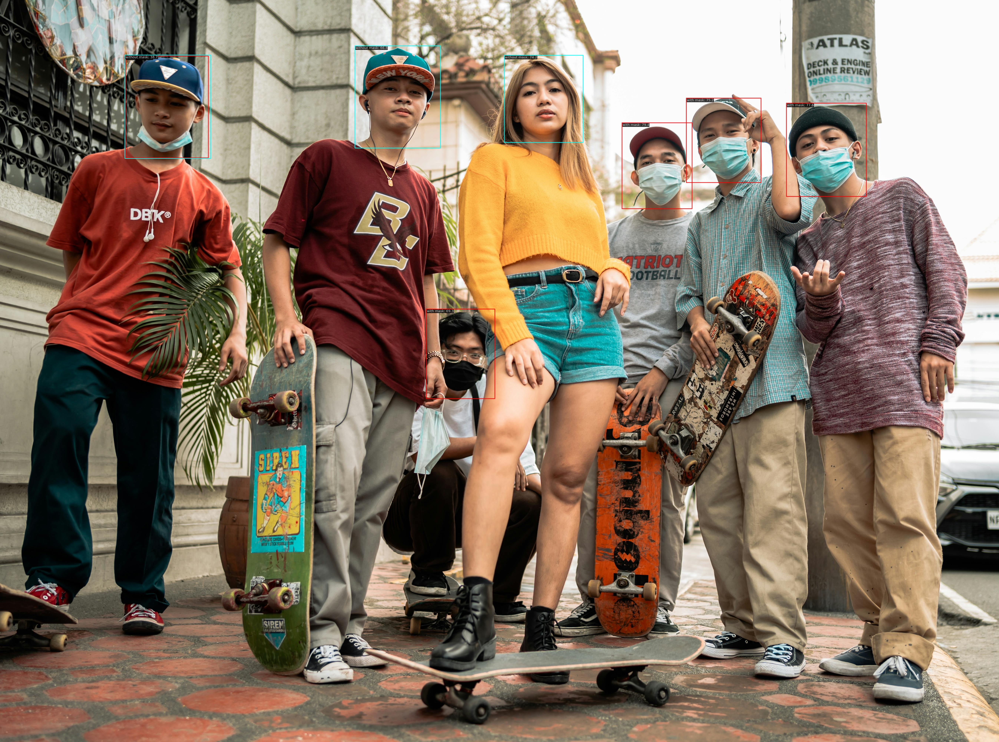

In [15]:
import cv2
from google.colab.patches import cv2_imshow

image_path = "output/skate.jpg"
img = cv2.imread(image_path)
if img is not None:
    cv2_imshow(img)
else:
    print("Gambar tidak ditemukan atau tidak dapat dibuka.")
